<a href="https://colab.research.google.com/github/robgon-art/GANscapes/blob/main/3_GANscapes_Filter_Images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import glob
image_files = sorted(glob.glob("/content/drive/MyDrive/impressionist_landscapes_resized/*.jpg"))
print(len(image_files))
print(image_files[:4])

5314
['/content/drive/MyDrive/impressionist_landscapes_resized/a-y-jackson_a-copse-evening-1918.jpg', '/content/drive/MyDrive/impressionist_landscapes_resized/a-y-jackson_early-spring-quebec-1923.jpg', '/content/drive/MyDrive/impressionist_landscapes_resized/a-y-jackson_entrance-to-halifax-harbour-1919.jpg', '/content/drive/MyDrive/impressionist_landscapes_resized/a-y-jackson_first-snow-algoma-country-1920.jpg']


In [ ]:
import numpy as np
import torch
print("Torch version:", torch.__version__)

Torch version: 1.7.1+cu101


In [ ]:
!wget https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt -O model.pt

--2021-03-04 20:59:46--  https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.19, 13.107.213.19, 2620:1ec:bdf::19, ...
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.19|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 353976522 (338M) [application/octet-stream]
Saving to: ‘model.pt’

model.pt            100%[===================>] 337.58M  54.3MB/s    in 6.0s    

2021-03-04 20:59:52 (56.3 MB/s) - ‘model.pt’ saved [353976522/353976522]



In [ ]:
model = torch.jit.load("model.pt").cuda().eval()
input_resolution = model.input_resolution.item()
context_length = model.context_length.item()
vocab_size = model.vocab_size.item()

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Model parameters: 151,277,313
Input resolution: 224
Context length: 77
Vocab size: 49408


In [ ]:
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from PIL import Image

preprocess = Compose([
    Resize(input_resolution, interpolation=Image.BICUBIC),
    ToTensor()
])

image_mean = torch.tensor([0.48145466, 0.4578275, 0.40821073]).cuda()
image_std = torch.tensor([0.26862954, 0.26130258, 0.27577711]).cuda()

In [ ]:
!wget https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz -O bpe_simple_vocab_16e6.txt.gz

--2021-03-04 21:00:00--  https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.19, 13.107.213.19, 2620:1ec:bdf::19, ...
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.19|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1356917 (1.3M) [application/octet-stream]
Saving to: ‘bpe_simple_vocab_16e6.txt.gz’

bpe_simple_vocab_16 100%[===================>]   1.29M  --.-KB/s    in 0.07s   

2021-03-04 21:00:00 (18.6 MB/s) - ‘bpe_simple_vocab_16e6.txt.gz’ saved [1356917/1356917]



In [ ]:
!pip install ftfy

     |████████████████████████████████| 71kB 6.2MB/s 
  Created wheel for ftfy: filename=ftfy-5.9-cp37-none-any.whl size=46451 sha256=e7eeb08d3f2171b9c597dc6512b7d4b1d3b4a503d08d970fa67de10cebd22ae9
  Stored in directory: /root/.cache/pip/wheels/5e/2e/f0/b07196e8c929114998f0316894a61c752b63bfa3fdd50d2fc3
Successfully built ftfy


In [ ]:
import os
from functools import lru_cache
import ftfy
import regex as re

@lru_cache()
def bytes_to_unicode():
    """
    Returns list of utf-8 byte and a corresponding list of unicode strings.
    The reversible bpe codes work on unicode strings.
    This means you need a large # of unicode characters in your vocab if you want to avoid UNKs.
    When you're at something like a 10B token dataset you end up needing around 5K for decent coverage.
    This is a signficant percentage of your normal, say, 32K bpe vocab.
    To avoid that, we want lookup tables between utf-8 bytes and unicode strings.
    And avoids mapping to whitespace/control characters the bpe code barfs on.
    """
    bs = list(range(ord("!"), ord("~")+1))+list(range(ord("¡"), ord("¬")+1))+list(range(ord("®"), ord("ÿ")+1))
    cs = bs[:]
    n = 0
    for b in range(2**8):
        if b not in bs:
            bs.append(b)
            cs.append(2**8+n)
            n += 1
    cs = [chr(n) for n in cs]
    return dict(zip(bs, cs))


def get_pairs(word):
    """Return set of symbol pairs in a word.
    Word is represented as tuple of symbols (symbols being variable-length strings).
    """
    pairs = set()
    prev_char = word[0]
    for char in word[1:]:
        pairs.add((prev_char, char))
        prev_char = char
    return pairs

def basic_clean(text):
    text = ftfy.fix_text(text)
    text = html.unescape(html.unescape(text))
    return text.strip()

def whitespace_clean(text):
    text = re.sub(r'\s+', ' ', text)
    text = text.strip()
    return text

class SimpleTokenizer(object):
    def __init__(self, bpe_path: str = "bpe_simple_vocab_16e6.txt.gz"):
        self.byte_encoder = bytes_to_unicode()
        self.byte_decoder = {v: k for k, v in self.byte_encoder.items()}
        merges = gzip.open(bpe_path).read().decode("utf-8").split('\n')
        merges = merges[1:49152-256-2+1]
        merges = [tuple(merge.split()) for merge in merges]
        vocab = list(bytes_to_unicode().values())
        vocab = vocab + [v+'</w>' for v in vocab]
        for merge in merges:
            vocab.append(''.join(merge))
        vocab.extend(['<|startoftext|>', '<|endoftext|>'])
        self.encoder = dict(zip(vocab, range(len(vocab))))
        self.decoder = {v: k for k, v in self.encoder.items()}
        self.bpe_ranks = dict(zip(merges, range(len(merges))))
        self.cache = {'<|startoftext|>': '<|startoftext|>', '<|endoftext|>': '<|endoftext|>'}
        self.pat = re.compile(r"""<\|startoftext\|>|<\|endoftext\|>|'s|'t|'re|'ve|'m|'ll|'d|[\p{L}]+|[\p{N}]|[^\s\p{L}\p{N}]+""", re.IGNORECASE)

    def bpe(self, token):
        if token in self.cache:
            return self.cache[token]
        word = tuple(token[:-1]) + ( token[-1] + '</w>',)
        pairs = get_pairs(word)

        if not pairs:
            return token+'</w>'

        while True:
            bigram = min(pairs, key = lambda pair: self.bpe_ranks.get(pair, float('inf')))
            if bigram not in self.bpe_ranks:
                break
            first, second = bigram
            new_word = []
            i = 0
            while i < len(word):
                try:
                    j = word.index(first, i)
                    new_word.extend(word[i:j])
                    i = j
                except:
                    new_word.extend(word[i:])
                    break

                if word[i] == first and i < len(word)-1 and word[i+1] == second:
                    new_word.append(first+second)
                    i += 2
                else:
                    new_word.append(word[i])
                    i += 1
            new_word = tuple(new_word)
            word = new_word
            if len(word) == 1:
                break
            else:
                pairs = get_pairs(word)
        word = ' '.join(word)
        self.cache[token] = word
        return word

    def encode(self, text):
        bpe_tokens = []
        text = whitespace_clean(basic_clean(text)).lower()
        for token in re.findall(self.pat, text):
            token = ''.join(self.byte_encoder[b] for b in token.encode('utf-8'))
            bpe_tokens.extend(self.encoder[bpe_token] for bpe_token in self.bpe(token).split(' '))
        return bpe_tokens

    def decode(self, tokens):
        text = ''.join([self.decoder[token] for token in tokens])
        text = bytearray([self.byte_decoder[c] for c in text]).decode('utf-8', errors="replace").replace('</w>', ' ')
        return text

In [ ]:
!pip install ipyplot

In [ ]:
import random
import array
all_images = []
all_file_names = []

for i, f in enumerate(image_files):
  try:
    image = Image.open(f)
    all_images.append(image)
    all_file_names.append(f)
  except:
    print("error reading", f)

  if i%100 == 0:
    print(i)

print ("Total no of images retrived: ", len(all_images))

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
Total no of images retrived:  5314



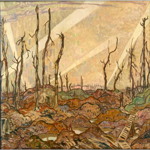
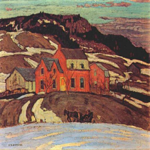
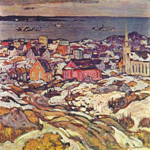
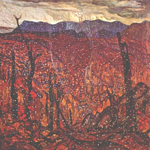
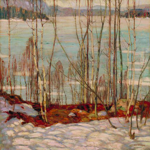
...
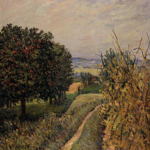
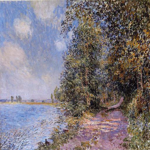
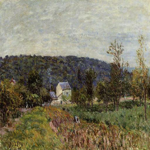
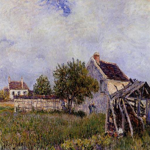
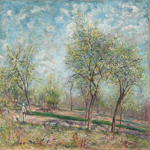

In [ ]:
import ipyplot
ipyplot.plot_images(all_images, max_images=44, img_width=150)

In [ ]:
image_features = torch.empty((0, 512))
step = 1000

for start in range(0, len(all_images), step):
  end = min(start + step, len(all_images))
  print(start, end)
  images = [preprocess(im) for im in all_images[start:end]]
  image_input = torch.tensor(np.stack(images)).cuda()
  image_input -= image_mean[:, None, None]
  image_input /= image_std[:, None, None]
  with torch.no_grad():
    image_feature_batch = model.encode_image(image_input).float()
  image_features = torch.cat([image_features, image_feature_batch.cpu()], dim=0)
  
image_features /= image_features.norm(dim=-1, keepdim=True)

0 1000
1000 2000
2000 3000
3000 4000
4000 5000
5000 5314


In [ ]:
import gzip
tokenizer = SimpleTokenizer()

def get_text_features(sentence):
  text_tokens = [tokenizer.encode("%s "%(sentence) + "<|endoftext|>")]
  text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)
  for i, tokens in enumerate(text_tokens):
    text_input[i, :len(tokens)] = torch.tensor(tokens)
    
  text_input = text_input.cuda()
  with torch.no_grad():
    text_features = model.encode_text(text_input).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

  return text_features

def get_top_N_semantic_similarity(similarity_list, N, reverse):
  results = zip(range(len(similarity_list)), similarity_list)
  results = sorted(results, key=lambda x: x[1], reverse=reverse)
  top_N_images = []
  scores = []
  indices = []
  for index,score in results[:N]:
    scores.append(score)
    top_N_images.append(all_images[index])
    indices.append(index)
  return scores, top_N_images, indices

scores  [0.31165123, 0.31066126, 0.310374, 0.31003195, 0.30991867, 0.30916333, 0.30813777, 0.30737263, 0.3067879, 0.30627587, 0.30585927, 0.30576962, 0.30569875, 0.30559722, 0.3054799, 0.30513376, 0.3050246, 0.30466446, 0.30295947, 0.3026179, 0.30258626, 0.3024747, 0.30236045, 0.30217516, 0.30214733, 0.3018522, 0.30180907, 0.30163252]



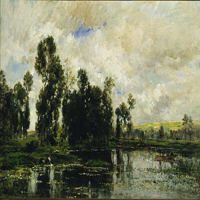
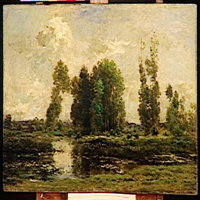
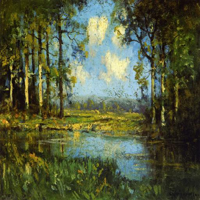
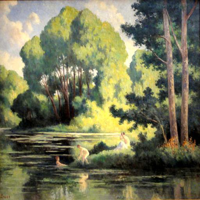
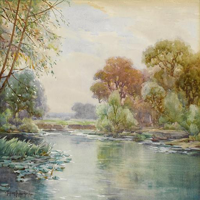
...
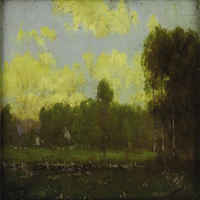
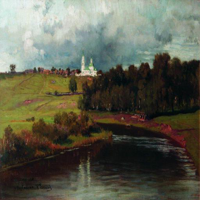
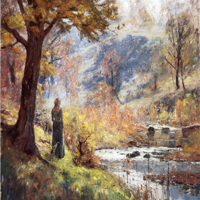
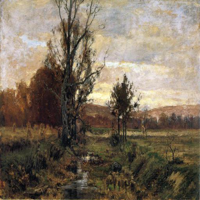
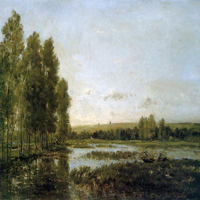

In [ ]:
import html
semantic_search_phrase = "impressionist landscape painting"
text_features_extracted = get_text_features(semantic_search_phrase)
similarity = text_features_extracted.cpu().numpy() @ image_features.cpu().numpy().T

similarity = similarity[0]
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 28, True)
print("scores ", scores)
result_labels = []
ipyplot.plot_images(imgs, img_width=200)

scores  [0.20104668, 0.2055786, 0.20745845, 0.20830584, 0.20846523, 0.21112233, 0.2116583, 0.21239449, 0.21524845, 0.21548781, 0.21672529, 0.21815225, 0.21920514, 0.21997689, 0.22034289, 0.22045891, 0.22161044, 0.2220689, 0.22254136, 0.22338803, 0.22377674, 0.2246604, 0.22479522, 0.22501568, 0.22505401, 0.22572424, 0.22583313, 0.22647527]



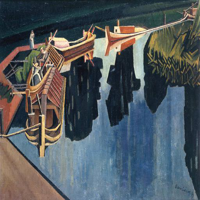
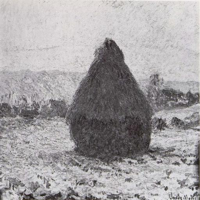
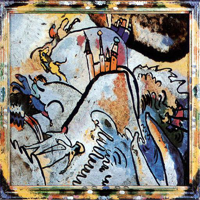
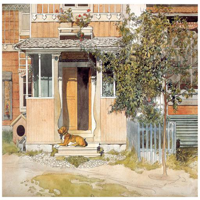
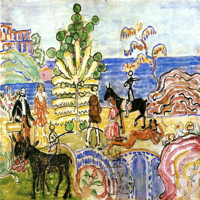
...
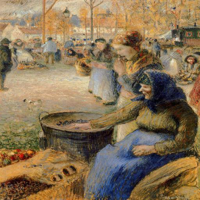
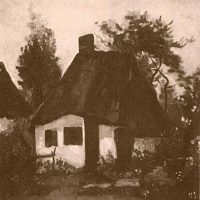
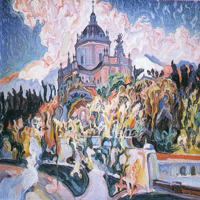
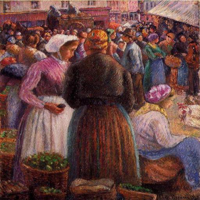
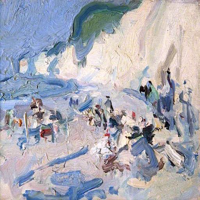

In [ ]:
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 28, False)
print("scores ", scores)
ipyplot.plot_images(imgs, img_width=200)

scores  [0.31165123, 0.31066126, 0.310374, 0.31003195, 0.30991867, 0.30916333, 0.30813777, 0.30737263, 0.3067879, 0.30627587, 0.30585927, 0.30576962, 0.30569875, 0.30559722, 0.3054799, 0.30513376, 0.3050246, 0.30466446, 0.30295947, 0.3026179, 0.30258626, 0.3024747, 0.30236045, 0.30217516, 0.30214733, 0.3018522, 0.30180907, 0.30163252, 0.30154, 0.3013805, 0.3011546, 0.30114293, 0.30109185, 0.30089992, 0.30074322, 0.30062932, 0.30045778, 0.30014557, 0.2999942, 0.29988608, 0.29980376, 0.29973787, 0.29964826, 0.2996454, 0.29960197, 0.29940072, 0.29938042, 0.29916263, 0.2990619, 0.29904345, 0.29894495, 0.29876643, 0.29872876, 0.29868832, 0.29860336, 0.29853815, 0.29849714, 0.29845423, 0.29822704, 0.2980423, 0.2979329, 0.29792133, 0.29779455, 0.29778057, 0.29777244, 0.29756844, 0.29751962, 0.297449, 0.29736134, 0.2972849, 0.29727584, 0.29722306, 0.2971811, 0.29704177, 0.29696625, 0.2968333, 0.29681408, 0.2966621, 0.29649973, 0.2964825, 0.29647425, 0.29644006, 0.29617614, 0.29592392, 0.295899


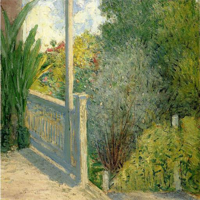
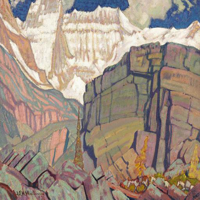
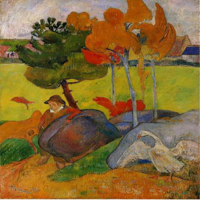
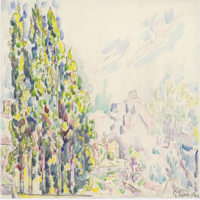
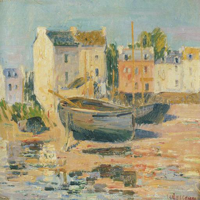
...
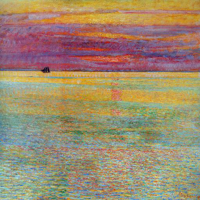
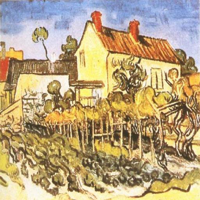
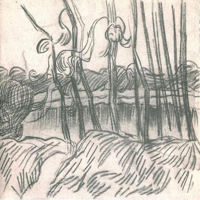
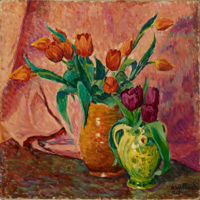
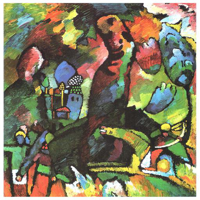

In [ ]:
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 5000, True)
print("scores ", scores)
ipyplot.plot_images(imgs[4972:5000], img_width=200)

In [ ]:
import shutil
scores, imgs, indices = get_top_N_semantic_similarity(similarity, 314, False)
for index in indices:
  src_file = image_files[index]
  dst_file = src_file.replace("impressionist_landscapes_resized", "salon_des_refuses")
  # print(src_file, dst_file)
  shutil.move(src_file, dst_file)

In [ ]:
!ls /content/drive/MyDrive/impressionist_landscapes_resized/ | wc -l

5000
